In [1]:
import igraph
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import os
import pygraphviz
os.chdir("../src")
from build_network_object import build_network_object
from draw_network_by_classification import draw_network_by_classification, compare_degrees_strength
from draw_adjacency_matrix import draw_adjacency_matrix
from draw_and_print_communities import draw_and_print_communities, compare_comunity_intersection
from correlations import correlation_industry_pairs, correlation_network_degree,correlation_adjacency_matrix
from networkx_functions import build_networx_network
import seaborn as sns
import networkx as nx

In [2]:
label1 = "Table1_Reduced_matrix_2009_2018_flows"
reduced_matrix_2009_2018 = pd.read_csv("../data/"+label1+".csv", index_col=0)

reduced_matrix_2009_2018_flows = reduced_matrix_2009_2018[reduced_matrix_2009_2018['StartIndst']!=0]

sub_matrix_2009_2018_less1 = reduced_matrix_2009_2018_flows[reduced_matrix_2009_2018_flows['weight']<1].sort_values(by=['weight'], ascending=False)
sub_matrix_2009_2018_flows = sub_matrix_2009_2018_less1[sub_matrix_2009_2018_less1['weight']>0].sort_values(by=['weight'], ascending=False)

print ("Number of links:", sub_matrix_2009_2018_flows.shape[0]/2)
print ("Number of 4-digit industries observed:")
print (len(np.unique([sub_matrix_2009_2018_flows['StartIndst'].values,sub_matrix_2009_2018_flows['FinalIndst'].values])))
sub_matrix_2009_2018_flows[1:15]

Number of links: 1153.0
Number of 4-digit industries observed:
356


,StartIndst,FinalIndst,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts
4302,4611,4623,0.999931,"Agriculture, animals, raw goods",Live animals,Fee/contract - wholesale,Agricultural wholesale,"Wholesale and retail,motor vehicle repair,sale...","Wholesale and retail,motor vehicle repair,sale...",10
4281,2732,2731,0.999828,"Other electronic, electric wires",Fibre optic cables,Electrical equipment,Electrical equipment,"Manufacture computer, electronic, light electr...","Manufacture computer, electronic, light electr...",10
4221,2731,2732,0.999821,Fibre optic cables,"Other electronic, electric wires",Electrical equipment,Electrical equipment,"Manufacture computer, electronic, light electr...","Manufacture computer, electronic, light electr...",11
4186,1813,1712,0.999697,"Pre-press, pre-media services","Paper, paperboard",Printing,Paper and paper products,All other Manufacturing,All other Manufacturing,10
4137,1712,1813,0.999649,"Paper, paperboard","Pre-press, pre-media services",Paper and paper products,Printing,All other Manufacturing,All other Manufacturing,18
3986,3040,3311,0.999642,Military fighting vehicles,Fabricated metal products,Other transport equipment,Repair/installation excl. household,"Manufacture machinery, vehicle, transport",Machinery repair excluding motor vehicles,10
4169,2899,2620,0.999599,Other,"Computers, peripheral equipment",Special purpose machinery,"Computer, electronic, optical","Manufacture machinery, vehicle, transport","Manufacture computer, electronic, light electr...",15
4218,2620,2899,0.999597,"Computers, peripheral equipment",Other,"Computer, electronic, optical",Special purpose machinery,"Manufacture computer, electronic, light electr...","Manufacture machinery, vehicle, transport",12
4276,2312,2311,0.999567,"Flat glass shaping, processing",Flat glass manufacture,Glass products,Glass products,All other Manufacturing,All other Manufacturing,10
4304,3311,3040,0.999539,Fabricated metal products,Military fighting vehicles,Repair/installation excl. household,Other transport equipment,Machinery repair excluding motor vehicles,"Manufacture machinery, vehicle, transport",25


In [3]:
sub_matrix_2009_2018_flows.loc[sub_matrix_2009_2018_flows['SubActivity_StartIndst'] == 'Other', 'SubActivity_StartIndst'] =  pd.Series(sub_matrix_2009_2018_flows.loc[sub_matrix_2009_2018_flows['SubActivity_StartIndst']=='Other']['SubActivity_StartIndst'] +" in "+ sub_matrix_2009_2018_flows.loc[sub_matrix_2009_2018_flows['SubActivity_StartIndst']=='Other']['MainActivity_StartIndst'])
sub_matrix_2009_2018_flows.loc[sub_matrix_2009_2018_flows['SubActivity_FinalIndst'] == 'Other', 'SubActivity_FinalIndst'] =  pd.Series(sub_matrix_2009_2018_flows.loc[sub_matrix_2009_2018_flows['SubActivity_FinalIndst']=='Other']['SubActivity_FinalIndst'] +" in "+ sub_matrix_2009_2018_flows.loc[sub_matrix_2009_2018_flows['SubActivity_FinalIndst']=='Other']['MainActivity_FinalIndst'])


In [4]:
label1 = "Node_list_SR_Sept_2019"
manchester_matrix_2009_2018 = pd.read_csv("../data/"+label1+".csv", index_col=0)

manchester_matrix_2009_2018['StartIndst'] = manchester_matrix_2009_2018.index

manchester_matrix_2009_2018.shape

manchester_matrix_2009_2018

,Label,community,employment_count,lq,lq_true,Eccentricity,closnesscentrality,harmonicclosnesscentrality,betweenesscentrality,Weighted Degree,StartIndst
Id,,,,,,,,,,,
161,Support crop prod,1.0,150.0,0.34,0.0,4,0.406948,0.436822,138.099369,3.9233,161
162,Support animal prod,1.0,150.0,0.49,0.0,4,0.405606,0.432080,91.750934,2.1555,162
170,Hunting,1.0,40.0,0.91,0.0,5,0.314578,0.326287,0.366970,0.7571,170
210,Siviculture,1.0,100.0,0.28,0.0,4,0.400651,0.427676,253.267011,3.3485,210
240,Forestry support,1.0,100.0,0.65,0.0,4,0.435013,0.468157,643.103700,4.8101,240
311,Marine fishing,3.0,10.0,0.06,0.0,5,0.326693,0.336958,2.064702,0.4221,311
899,Other mining,1.0,5.0,0.13,0.0,4,0.361499,0.379743,13.977132,1.4238,899
910,Petrol gas extraction support,6.0,40.0,0.05,0.0,4,0.454294,0.485264,215.440574,5.3110,910
1011,Meat processing,2.0,600.0,0.57,0.0,4,0.450549,0.481877,187.474053,3.5388,1011


In [5]:
result = pd.merge(manchester_matrix_2009_2018[['Label','StartIndst','employment_count','lq_true','lq']],sub_matrix_2009_2018_flows,on=['StartIndst'],how='outer')

result['LabelStartIndst'] = result['Label']
result['EmploymentCountStartIndst'] = result['employment_count']
result['LqStartIndst'] = result['lq_true']



result.drop(['Label','employment_count','lq_true'],axis=1,inplace=True)

result.head()

,StartIndst,lq,FinalIndst,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst
0,161,0.34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support crop prod,150.0,0.0
1,162,0.49,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support animal prod,150.0,0.0
2,170,0.91,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Hunting,40.0,0.0
3,210,0.28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Siviculture,100.0,0.0
4,240,0.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Forestry support,100.0,0.0


In [6]:
manchester_matrix_2009_2018['FinalIndst'] = manchester_matrix_2009_2018.index

result_final = pd.merge(manchester_matrix_2009_2018[['Label','FinalIndst','employment_count','lq_true']],result,on=['FinalIndst'],how='outer')

result_final['LabelFinalIndst'] = result_final['Label']
result_final['EmploymentCountFinalIndst'] = result_final['employment_count']
result_final['LqFinalIndst'] = result_final['lq_true']


result_final.drop(['Label','employment_count','lq_true'],axis=1,inplace=True)


result_final.head()

,FinalIndst,StartIndst,lq,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst,LabelFinalIndst,EmploymentCountFinalIndst,LqFinalIndst
0,161.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support crop prod,150.0,0.0
1,162.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support animal prod,150.0,0.0
2,170.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Hunting,40.0,0.0
3,210.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Siviculture,100.0,0.0
4,240.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Forestry support,100.0,0.0


In [7]:
result_final['isManchester'] = result_final['LqFinalIndst'] + result_final['LqStartIndst']

result_final_onlyMan = result_final[result_final['isManchester']==2]
result_final_notMan = result_final[result_final['isManchester']!=2]

In [8]:
network_largest_2009_2018_nx_manchester= build_networx_network(result_final_onlyMan,'weight')

network_largest_2008_2018_max_span_tree_manchester = nx.maximum_spanning_tree(network_largest_2009_2018_nx_manchester)
weights_manchester = [3*network_largest_2008_2018_max_span_tree_manchester[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]
color = ['red' for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]

network_largest_2008_2018_max_span_tree_manchester

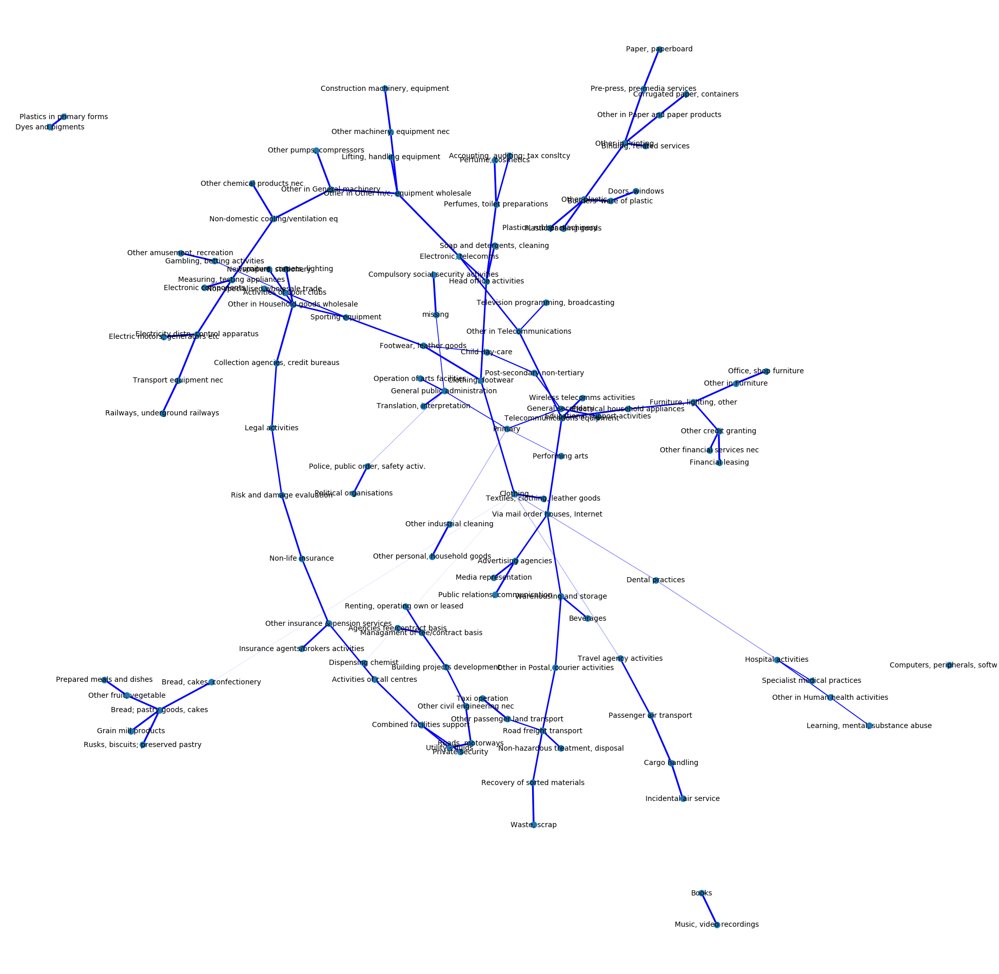

In [21]:

elarge = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree_manchester.edges(data=True) if d['weight'] > 0.0]


fig=plt.figure(figsize=(50, 50), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.spring_layout(network_largest_2008_2018_max_span_tree_manchester)
nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree_manchester,pos=pos)
nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree_manchester, pos=pos,font_size=20)
nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=elarge,edge_color = 'blue')
plt.savefig("../img/Manchester_only.png")


plt.axis('off')
plt.show()

In [22]:
network_largest_2009_2018_nx= build_networx_network(result_final,'weight')

network_largest_2008_2018_max_span_tree = nx.maximum_spanning_tree(network_largest_2009_2018_nx)
weights = [10*network_largest_2008_2018_max_span_tree[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree.edges()]
weights_manchester = [10*network_largest_2008_2018_max_span_tree_manchester[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]

color = ['red' for u,v in network_largest_2008_2018_max_span_tree.edges()]


In [26]:
network_largest_2008_2018_max_span_tree = [network_largest_2008_2018_max_span_tree.subgraph(c) for c in nx.connected_components(network_largest_2008_2018_max_span_tree)][0]

elarge = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree.edges(data=True) if d['weight'] > 0.0]
eman = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree_manchester.edges(data=True) if d['weight'] > 0.0]

elarge_node = [u for u in network_largest_2008_2018_max_span_tree.nodes() ]
eman_node = [u for u in network_largest_2008_2018_max_span_tree_manchester.nodes()]

e_not_man = set(elarge_node) - set(eman_node)

labels_manchester = {k:k for k in e_not_man}    


fig=plt.figure(figsize=(300, 300), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.nx_agraph.graphviz_layout(network_largest_2008_2018_max_span_tree,prog='sfdp')

nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree,pos=pos,node_size=2200)


nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree,pos=pos,width=weights,edgelist=elarge,edge_color = 'blue')
nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=eman,node_color = 'red',node_size=2200)
nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=eman,edge_color = 'red')

nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree_manchester, pos=pos,font_size=60,font_color='red')
nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree,pos, labels_manchester,nodelist=e_not_man,font_size=60,font_color='grey')

plt.axis('off')
#plt.show()
plt.savefig("../img/Manchester_UK_study_MST.png")



In [30]:
weights = [5*network_largest_2009_2018_nx[u][v]['weight'] for u,v in network_largest_2009_2018_nx.edges()]
weights_manchester = [5*network_largest_2009_2018_nx_manchester[u][v]['weight'] for u,v in network_largest_2009_2018_nx_manchester.edges()]


network_largest_2009_2018_nx = [network_largest_2009_2018_nx.subgraph(c) for c in nx.connected_components(network_largest_2008_2018_max_span_tree)][0]

elarge = [(u, v) for (u, v, d) in network_largest_2009_2018_nx.edges(data=True) if d['weight'] > 0.8]
eman = [(u, v) for (u, v, d) in network_largest_2009_2018_nx_manchester.edges(data=True) if d['weight'] > 0.8]

elarge_node = [u for u in network_largest_2009_2018_nx.nodes() ]
eman_node = [u for u in network_largest_2009_2018_nx_manchester.nodes()]

e_not_man = set(elarge_node) - set(eman_node)

labels_manchester = {k:k for k in e_not_man}    


fig=plt.figure(figsize=(300, 300), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.spring_layout(network_largest_2009_2018_nx)
pos = nx.nx_agraph.graphviz_layout(network_largest_2009_2018_nx,prog='sfdp')

nx.draw_networkx_nodes(network_largest_2009_2018_nx,pos=pos,node_size=5200)


nx.draw_networkx_edges(network_largest_2009_2018_nx,pos=pos,width=weights,edgelist=elarge,edge_color = 'blue')
nx.draw_networkx_nodes(network_largest_2009_2018_nx_manchester,pos=pos,width=weights_manchester,edgelist=eman,node_color = 'red',node_size=5200)
nx.draw_networkx_edges(network_largest_2009_2018_nx_manchester,pos=pos,width=weights_manchester,edgelist=eman,edge_color = 'red')

nx.draw_networkx_labels(network_largest_2009_2018_nx_manchester, pos=pos,font_size=80,font_color='red')
nx.draw_networkx_labels(network_largest_2009_2018_nx,pos, labels_manchester,nodelist=e_not_man,font_size=60,font_color='grey')

plt.axis('off')
#plt.show()
plt.savefig("../img/Manchester_UK_study.png")


In [28]:
network_largest_2008_2018_max_span_tree = [network_largest_2008_2018_max_span_tree.subgraph(c) for c in nx.connected_components(network_largest_2008_2018_max_span_tree)][0]
weights = [5*network_largest_2008_2018_max_span_tree[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree.edges()]
weights_manchester = [5*network_largest_2008_2018_max_span_tree_manchester[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]

elarge = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree.edges(data=True) if d['weight'] > 0.0]
eman = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree_manchester.edges(data=True) if d['weight'] > 0.0]

elarge_node = [u for u in network_largest_2008_2018_max_span_tree.nodes() ]
eman_node = [u for u in network_largest_2008_2018_max_span_tree_manchester.nodes()]

e_not_man = set(elarge_node) - set(eman_node)

labels_manchester = {k:k for k in e_not_man}    


fig=plt.figure(figsize=(300, 300), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.nx_agraph.graphviz_layout(network_largest_2008_2018_max_span_tree,prog='sfdp')

nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree,pos=pos,node_size=2200)


nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree,pos=pos,width=weights,edgelist=elarge,edge_color = 'blue')
nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=eman,node_color = 'red',node_size=2200)

nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree_manchester, pos=pos,font_size=60,font_color='red')
nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree,pos, labels_manchester,nodelist=e_not_man,font_size=60,font_color='grey')

plt.axis('off')
#plt.show()
plt.savefig("../img/Manchester_UK_study_MST_noEdges.png")



In [32]:
result_final[result_final['SubActivity_StartIndst']=='Perfumes, toilet preparations']

,FinalIndst,StartIndst,lq,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst,LabelFinalIndst,EmploymentCountFinalIndst,LqFinalIndst,isManchester
600,4645.0,2042.0,1.67,0.982115,"Perfumes, toilet preparations","Perfume, cosmetics","Chemicals, chemical products",Household goods wholesale,"Manufacture coke, petroleum, chemicals, pharma...","Wholesale and retail,motor vehicle repair,sale...",21.0,Perfume manu,1250.0,1.0,Perfume wholesale,1750.0,1.0,2.0
1452,6920.0,2042.0,1.67,0.742646,"Perfumes, toilet preparations","Accounting, auditing; tax consltcy","Chemicals, chemical products",Legal and accounting activities,"Manufacture coke, petroleum, chemicals, pharma...",Business services,10.0,Perfume manu,1250.0,1.0,Accounting,23000.0,1.0,2.0
1471,7010.0,2042.0,1.67,0.967067,"Perfumes, toilet preparations",Head office activities,"Chemicals, chemical products",Head offices; mgment consultancy,"Manufacture coke, petroleum, chemicals, pharma...",Business services,39.0,Perfume manu,1250.0,1.0,Management consultancy,14000.0,1.0,2.0
1576,7219.0,2042.0,1.67,0.971418,"Perfumes, toilet preparations","Other natural sciences, engineering","Chemicals, chemical products","Scientific research, development","Manufacture coke, petroleum, chemicals, pharma...",Business services,32.0,Perfume manu,1250.0,1.0,Natural sciences R&D,2250.0,0.0,1.0
2496,7820.0,2042.0,1.67,0.342263,"Perfumes, toilet preparations",Temporary employment agencies,"Chemicals, chemical products",Employment activities,"Manufacture coke, petroleum, chemicals, pharma...",Business services,10.0,Perfume manu,1250.0,1.0,NaN,NaN,NaN,NaN


In [33]:
result_final[result_final['SubActivity_StartIndst']=='Other education nec']

,FinalIndst,StartIndst,lq,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst,LabelFinalIndst,EmploymentCountFinalIndst,LqFinalIndst,isManchester
1402,6630.0,8559.0,0.96,0.853632,Other education nec,Fund management activities,Other education,Auxiliary financial services,"Government administrative functions, Education...",Business services,18.0,Other ed,9000.0,0.0,Fund management,900.0,0.0,0.0
1492,7010.0,8559.0,0.96,0.116195,Other education nec,Head office activities,Other education,Head offices; mgment consultancy,"Government administrative functions, Education...",Business services,10.0,Other ed,9000.0,0.0,Management consultancy,14000.0,1.0,1.0
1532,7022.0,8559.0,0.96,0.248261,Other education nec,"Business, other management",Other education,Head offices; mgment consultancy,"Government administrative functions, Education...",Business services,29.0,Other ed,9000.0,0.0,Business consultancy,17000.0,0.0,0.0
1801,8299.0,8559.0,0.96,0.325334,Other education nec,"Other in Office admin, business support",Other education,"Office admin, business support","Government administrative functions, Education...",Business services,23.0,Other ed,9000.0,0.0,Other business support,11000.0,0.0,0.0
1859,8510.0,8559.0,0.96,0.705530,Other education nec,Pre-primary,Other education,Education,"Government administrative functions, Education...","Government administrative functions, Education...",13.0,Other ed,9000.0,0.0,Preschool,2500.0,0.0,0.0
1888,8531.0,8559.0,0.96,0.468350,Other education nec,General secondary,Other education,Education,"Government administrative functions, Education...","Government administrative functions, Education...",87.0,Other ed,9000.0,0.0,Sec ed,29000.0,1.0,1.0
1897,8532.0,8559.0,0.96,0.898654,Other education nec,"Technical, vocational secondary",Other education,Education,"Government administrative functions, Education...","Government administrative functions, Education...",228.0,Other ed,9000.0,0.0,VET,5000.0,0.0,0.0
1910,8541.0,8559.0,0.96,0.822177,Other education nec,Post-secondary non-tertiary,Other education,Education,"Government administrative functions, Education...","Government administrative functions, Education...",23.0,Other ed,9000.0,0.0,Post-sec adult ed,2500.0,1.0,1.0
1922,8542.0,8559.0,0.96,0.366715,Other education nec,Tertiary,Other education,Education,"Government administrative functions, Education...","Government administrative functions, Education...",58.0,Other ed,9000.0,0.0,Tertiary ed,20000.0,0.0,0.0
1955,8560.0,8559.0,0.96,0.914266,Other education nec,Educational support activities,Other education,Other education,"Government administrative functions, Education...","Government administrative functions, Education...",16.0,Other ed,9000.0,0.0,Education support,1500.0,1.0,1.0


In [34]:
result_final

,FinalIndst,StartIndst,lq,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst,LabelFinalIndst,EmploymentCountFinalIndst,LqFinalIndst,isManchester
0,161.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support crop prod,150.0,0.0,NaN
1,162.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support animal prod,150.0,0.0,NaN
2,170.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Hunting,40.0,0.0,NaN
3,210.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Siviculture,100.0,0.0,NaN
4,240.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Forestry support,100.0,0.0,NaN
5,311.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Marine fishing,10.0,0.0,NaN
6,899.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Other mining,5.0,0.0,NaN
7,910.0,2892.0,0.39,0.997151,"Mining, quarrying, construction","Petroleum, natural gas extraction",Special purpose machinery,Mining support activities,"Manufacture machinery, vehicle, transport","Mining, Quarrying (inc extraction of petroleum...",21.0,Mining machine manu,225.0,0.0,Petrol gas extraction support,40.0,0.0,0.0
8,910.0,7112.0,1.00,0.878065,Engineering/tech consultancy,"Petroleum, natural gas extraction","Architectural, eng/tech testing",Mining support activities,Business services,"Mining, Quarrying (inc extraction of petroleum...",10.0,Engineering,16000.0,0.0,Petrol gas extraction support,40.0,0.0,0.0
9,1011.0,1012.0,0.15,0.984805,"Poultry meat processing, preserving","Meat processing, preserving","Food products - meat, fish","Food products - meat, fish","Manufacture food, drink, tobacco","Manufacture food, drink, tobacco",10.0,Poultry processing,150.0,0.0,Meat processing,600.0,0.0,0.0


In [12]:
label1 = "Edge_list_SR_Sept_2019"
manchester_matrix_2009_2018_edges = pd.read_csv("../data/"+label1+".csv", index_col=0)
manchester_matrix_2009_2018_edges['Source'] = manchester_matrix_2009_2018_edges.index

manchester_matrix_2009_2018_edges.head()

print (manchester_matrix_2009_2018_edges.shape)

(6175, 4)


In [22]:
weight_UK = []
weight_Germany = []
weight_not_found =[]
for i in range(0,manchester_matrix_2009_2018_edges.shape[0]):
    source = manchester_matrix_2009_2018_edges.iloc[i]['Source']
    target = manchester_matrix_2009_2018_edges.iloc[i]['Target']
    
    weight = manchester_matrix_2009_2018_edges.iloc[i]['Weight']
    
    subset1 = reduced_matrix_2009_2018[(reduced_matrix_2009_2018['StartIndst']==source) & (reduced_matrix_2009_2018['FinalIndst']==target)]
    subset2 = reduced_matrix_2009_2018[(reduced_matrix_2009_2018['FinalIndst']==source) & (reduced_matrix_2009_2018['StartIndst']==target)]
    
    if subset1.shape[0]!=0:
        w_UK = subset1['weight'].values[0]
        
    elif (subset2.shape[0]!=0):
        w_UK = subset2['weight'].values[0]
        
    else:

        weight_not_found.append(weight)
        continue
    
    weight_UK.append(w_UK)
    weight_Germany.append(weight)
        

/anaconda3/envs/kflows/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


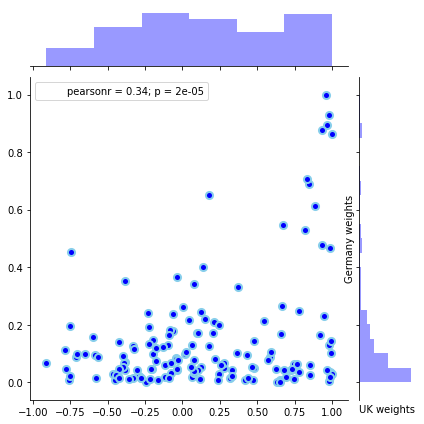

150


In [23]:
import seaborn as sns
import scipy.stats as stats
j = sns.jointplot(x=np.array(weight_UK), y=np.array(weight_Germany), kind='scatter', s=50, color='blue',edgecolor="skyblue",linewidth=2)

plt.xlabel('UK weights')
plt.ylabel('Germany weights')
j.annotate(stats.pearsonr)

plt.show()

print (len(weight_UK))

In [24]:
result_final[result_final['FinalIndst']==111]
result_final[result_final['StartIndst']==111]

,FinalIndst,StartIndst,lq,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst,LabelFinalIndst,EmploymentCountFinalIndst,LqFinalIndst,isManchester
2279,113.0,111.0,NaN,0.995486,"Cereals, leguminous crops, oilseeds","Vegetables, melons, roots, tubers",Growing crops,Growing crops,"Agriculture, Forestry, Fishing, Veterinary","Agriculture, Forestry, Fishing, Veterinary",11.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2284,150.0,111.0,NaN,0.998012,"Cereals, leguminous crops, oilseeds",Mixed farming,Growing crops,"Animal production, hunting","Agriculture, Forestry, Fishing, Veterinary","Agriculture, Forestry, Fishing, Veterinary",22.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


(array([91., 29., 11.,  4.,  4.,  2.,  3.,  1.,  3.,  2.]),
 array([0.0012 , 0.10108, 0.20096, 0.30084, 0.40072, 0.5006 , 0.60048,
        0.70036, 0.80024, 0.90012, 1.     ]),
 <a list of 10 Patch objects>)

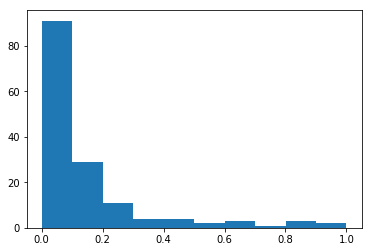

In [32]:
plt.hist(weight_Germany)


(array([12.,  9.,  9.,  5.,  7.,  4.,  9.,  7.,  6., 18.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

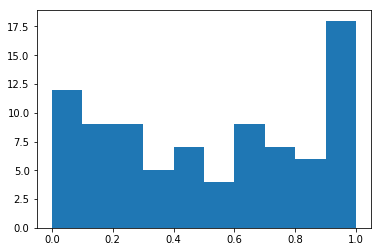

In [35]:
plt.hist(weight_UK,range=[0,1])


(array([2753., 1602.,  787.,  447.,  217.,  108.,   63.,   21.,   17.,
          10.]),
 array([1.0000e-04, 1.0009e-01, 2.0008e-01, 3.0007e-01, 4.0006e-01,
        5.0005e-01, 6.0004e-01, 7.0003e-01, 8.0002e-01, 9.0001e-01,
        1.0000e+00]),
 <a list of 10 Patch objects>)

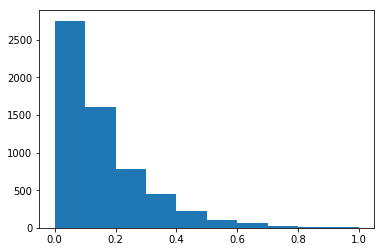

In [34]:
plt.hist(weight_not_found)

(array([2838., 1636.,  799.,  451.,  221.,  110.,   66.,   22.,   20.,
          12.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

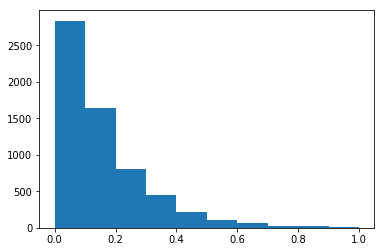

In [37]:
plt.hist(manchester_matrix_2009_2018_edges['Weight'],range=[0,1])
